In [1]:
import pandas as pd
import numpy as np
import re
import scanpy as sc
import anndata
from concurrent.futures import ThreadPoolExecutor, as_completed
from tqdm import tqdm
import scanpy.external as sce
import scyan

Global seed set to 0


In [65]:
meta_data=pd.read_csv('flow_meta_data.csv')

In [66]:
meta_data_selected_RNA=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/hise_meta_data_2024-01-23_fixed.csv')

In [67]:
meta_data_selected_RNA=meta_data_selected_RNA.query("Flu_Year.isin([2020,2021]) &`sample.visitName`.isin(['Flu Year 1 Day 0','Flu Year 1 Day 7','Flu Year 2 Day 0','Flu Year 2 Day 7'])")

In [68]:
meta_data=meta_data[meta_data['pbmc_sample_id'].isin(meta_data_selected_RNA['pbmc_sample_id'])]

In [70]:
def read_one(file_path):
    adata = scyan.read_csv(file_path,
                        marker_regex='^cd|^hla|tcr|ig|^ccr|klrg|^cx', 
                        exclude_markers=None)
    adata.obs["batch"] = re.findall( 'B\\d\\d\\d', file_path)[0]
    adata.obs["panel"] = re.findall( 'PB1|PT1|PM1|PS1', file_path)[0]

    return adata


In [71]:
%%time
file_names= meta_data['file.path']
adata_list = []
with ThreadPoolExecutor(max_workers=60) as executor:
    future_to_file = {executor.submit(read_one, file_name): file_name for file_name in file_names}
    for future in tqdm(as_completed(future_to_file), total=len(file_names)):
        result = future.result()
        if result is not None:
            adata_list.append(result)

100% 254/254 [02:39<00:00,  1.60it/s]

CPU times: user 10min 50s, sys: 1min 3s, total: 11min 54s
Wall time: 2min 39s


In [72]:
adata = anndata.concat(adata_list)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [73]:
adata.obs['labels'].value_counts()

labels
naive_cd4_t_cells    11323370
myeloid_cells         8375606
Unknown               7664884
em_cd4_t_cells        7281283
cm_cd4_t_cells        6883107
cd56mid_nk_cells      6640767
b_cells               4804408
em_cd8_t_cells        4488845
naive_cd8_t_cells     4464012
temra_cd8_t_cells     3387511
gd_t_cells            1942392
memory_treg           1492373
debris                 973165
naive_treg             704211
cm_cd8_t_cells         696266
cd56hi_nk_cells        607875
dn_t_cells             569267
temra_cd4_t_cells      492719
dp_t_cells             320619
cd103_cd8_t_cells      309996
cd103_cd4_t_cells      141474
ilc_like_cells          53781
Name: count, dtype: int64

In [91]:
adata_sub=adata[adata.obs['labels'].isin(['cm_cd4_t_cells','em_cd4_t_cells'])]

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [92]:
adata_sub

View of AnnData object with n_obs × n_vars = 14164390 × 25
    obs: 'Unnamed: 0', 'sample_id', 'cell_id', 'barcode', 'Time', 'SSC-W', 'SSC-H', 'SSC-A', 'FSC-W', 'FSC-H', 'FSC-A', 'SSC-B-W', 'SSC-B-H', 'SSC-B-A', 'Viability_logicle', 'labels', 'batch', 'panel'

In [93]:
scyan.preprocess.scale(adata_sub)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
[INFO] (scyan.preprocess) Data will be centered and standardised. This is advised only when using spectral/flow data (if this is not your case, consider running 'asinh_transform' instead of 'auto_logicle_transform').


In [94]:
sc.pp.pca(adata_sub, svd_solver="arpack")

In [ ]:
sce.pp.harmony_integrate(adata_sub, 'batch',max_iter_harmony = 20)


2024-03-27 17:48:31,437 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


In [95]:
gating_antigens =  adata.var_names

In [96]:
scyan.tools.umap(adata_sub, markers=gating_antigens)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
[INFO] (scyan.tools.representation) Fitting UMAP...


UMAP(min_dist=0.5, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True})

In [97]:
adata_sub_subsampled=sc.pp.subsample(adata_sub, n_obs=5000000, random_state=0, copy=True)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/scyan/plot/_scanpy_plot/umap.py:876: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use 

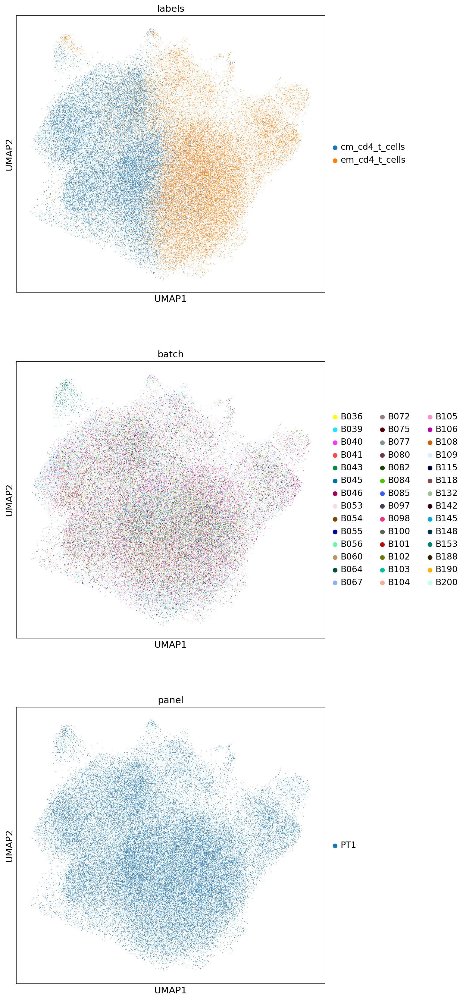

In [98]:
sc.set_figure_params(figsize=(8, 8))
p1=scyan.plot.umap(adata_sub_subsampled, color=['labels', 'batch','panel'],return_fig=True,ncols=1)
p1.set_size_inches(18.5, 10.5)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make 

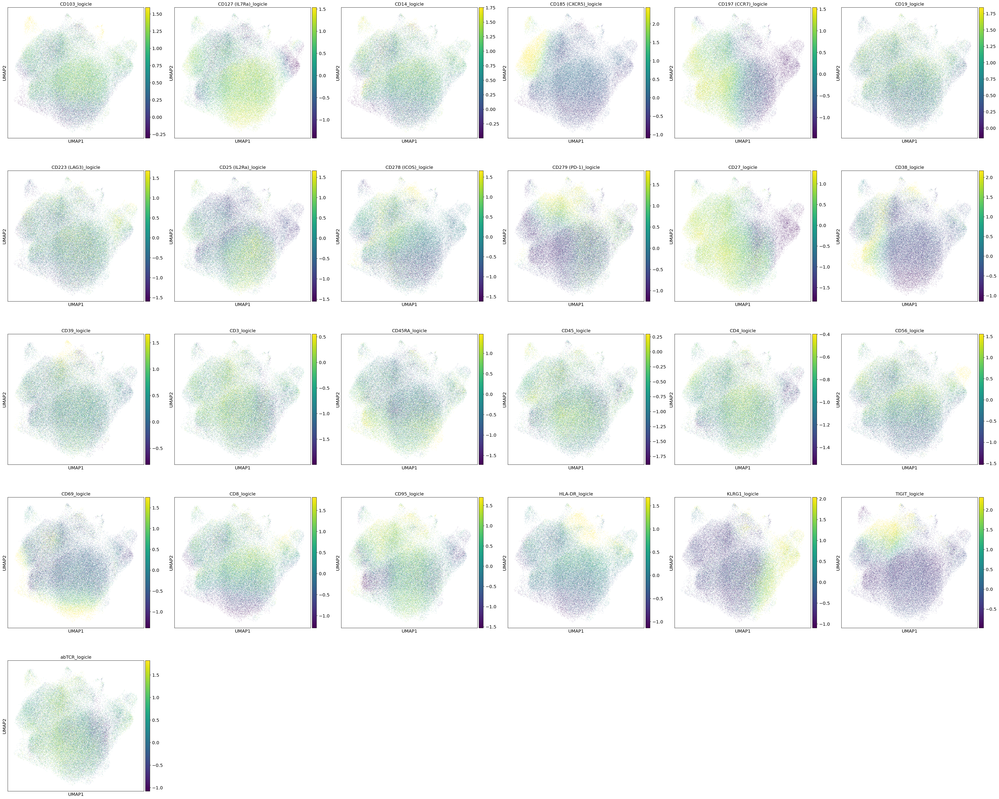

In [99]:
p1=scyan.plot.umap(adata_sub_subsampled, color=adata.var_names.sort_values(),ncols=6, show=True, return_fig=True)
p1.set_size_inches(18.5, 18.5)

In [100]:
adata.var_names

Index(['CD3_logicle', 'CD45_logicle', 'CD56_logicle', 'CD19_logicle',
       'CD27_logicle', 'CD8_logicle', 'CD39_logicle', 'CD103_logicle',
       'abTCR_logicle', 'CD223 (LAG3)_logicle', 'CD95_logicle',
       'CD127 (IL7Ra)_logicle', 'CD278 (ICOS)_logicle', 'CD45RA_logicle',
       'CD185 (CXCR5)_logicle', 'CD14_logicle', 'CD4_logicle',
       'HLA-DR_logicle', 'CD279 (PD-1)_logicle', 'TIGIT_logicle',
       'CD38_logicle', 'CD197 (CCR7)_logicle', 'CD69_logicle',
       'CD25 (IL2Ra)_logicle', 'KLRG1_logicle'],
      dtype='object')

In [101]:
from sklearn.mixture import GaussianMixture

In [107]:
gmm = GaussianMixture(n_components=2, random_state=0).fit(adata_sub_subsampled[:,['CD185 (CXCR5)_logicle','CD45RA_logicle']].X)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [108]:
labels = gmm.predict(adata_sub_subsampled[:,['CD185 (CXCR5)_logicle','CD45RA_logicle']].X)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [109]:
adata_sub_subsampled.obs['predicted_class']=labels

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make 

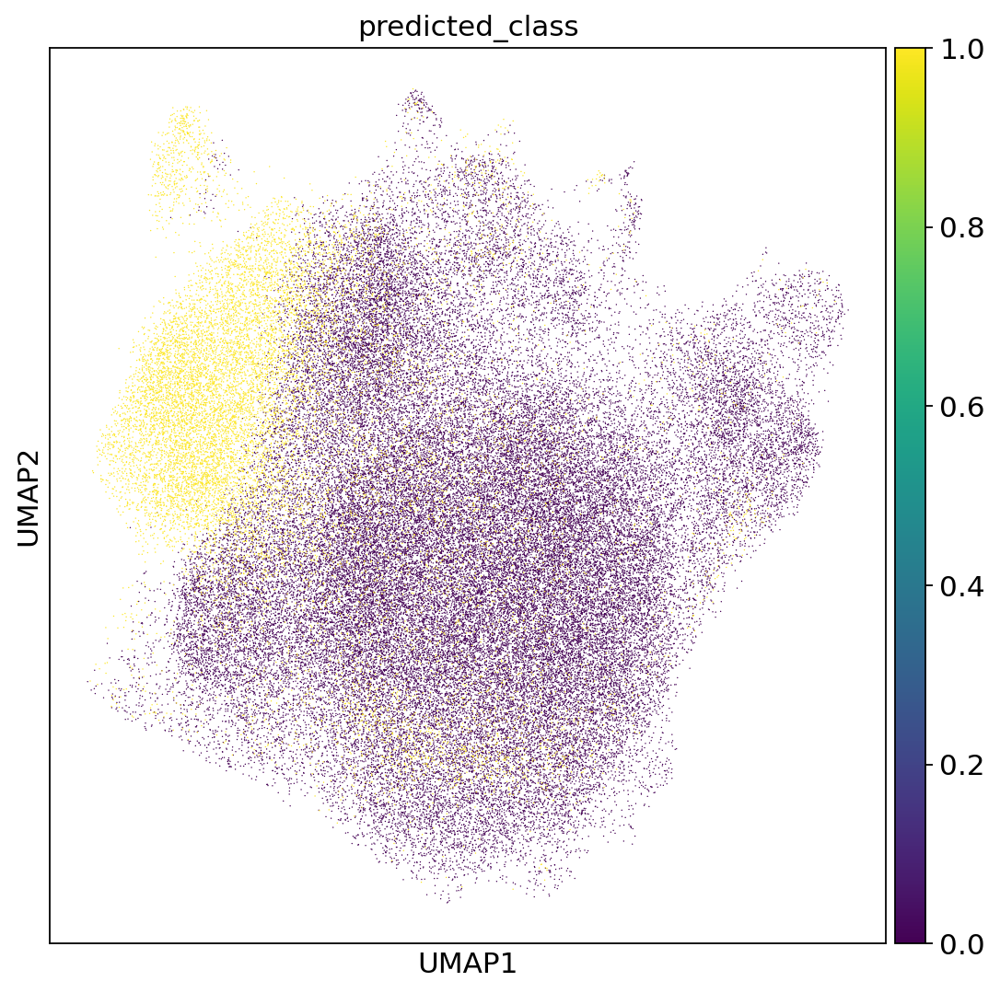

In [110]:
p1=scyan.plot.umap(adata_sub_subsampled, color='predicted_class',show=True, return_fig=True)
p1.set_size_inches(10, 10)

In [111]:
adata_sub_subsampled.obs['predicted_class'].value_counts()

predicted_class
0    4088266
1     911734
Name: count, dtype: int64

In [113]:
import matplotlib.pyplot as plt


In [138]:
x1=adata_sub_subsampled[:,['CD185 (CXCR5)_logicle']].X
y1=adata_sub_subsampled[:,['CD45RA_logicle']].X
x1=np.array(x1).flatten()
y1=np.array(y1).flatten()

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

<Axes: >

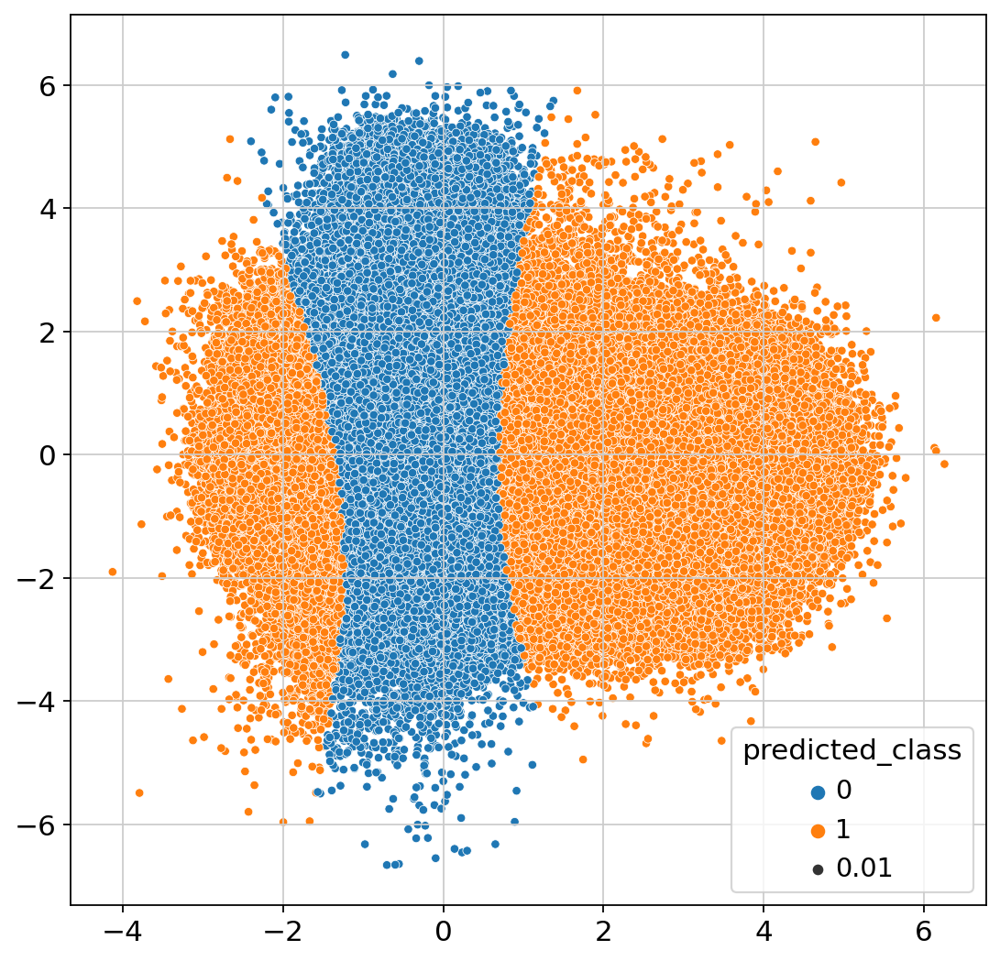

In [145]:
import seaborn as sns
sns.scatterplot( x=x1, y=y1,size=0.01,hue=adata_sub_subsampled.obs['predicted_class'])


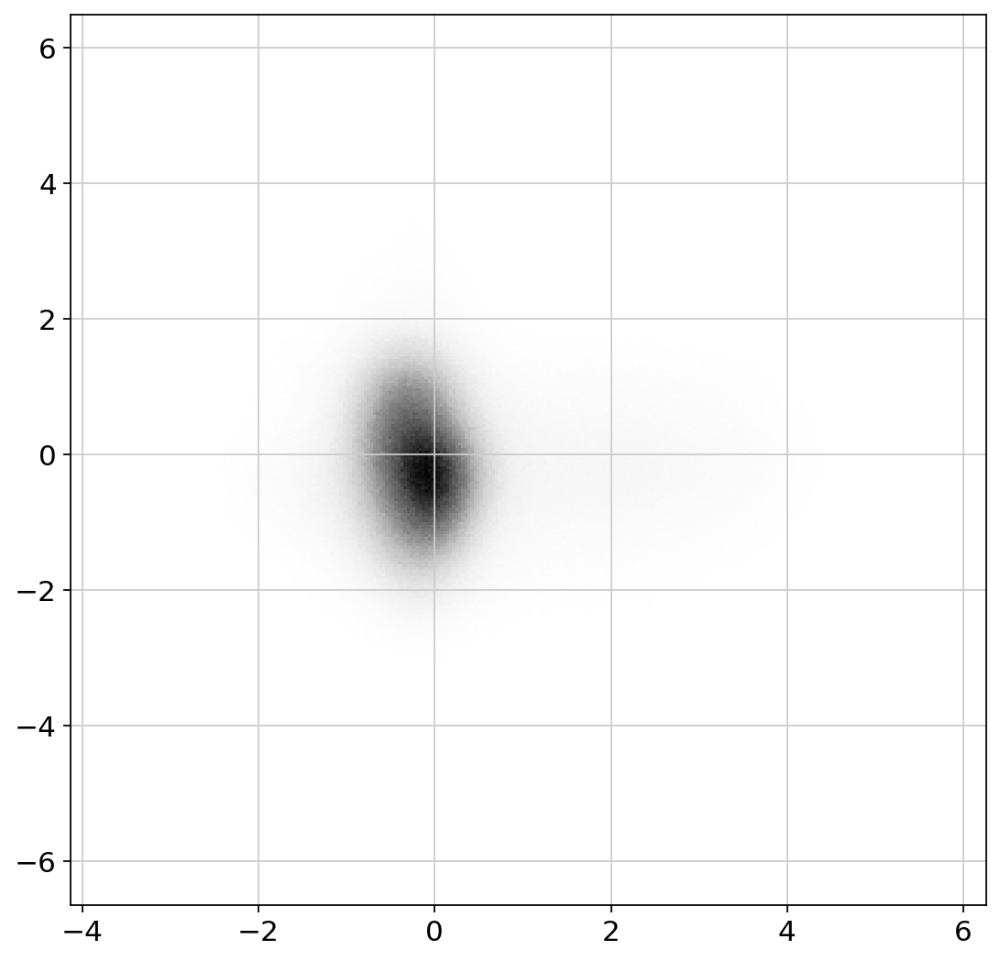

In [141]:
plt.hist2d( x1,y1, bins=(300, 300), cmap=plt.cm.Greys)
plt.show()

In [146]:
adata_sub=adata[adata.obs['labels'].isin(['cm_cd4_t_cells','em_cd4_t_cells','naive_cd4_t_cells','memory_treg','naive_treg'])]

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [147]:
adata_sub_subsampled=sc.pp.subsample(adata_sub, n_obs=5000000, random_state=0, copy=True)

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1118: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


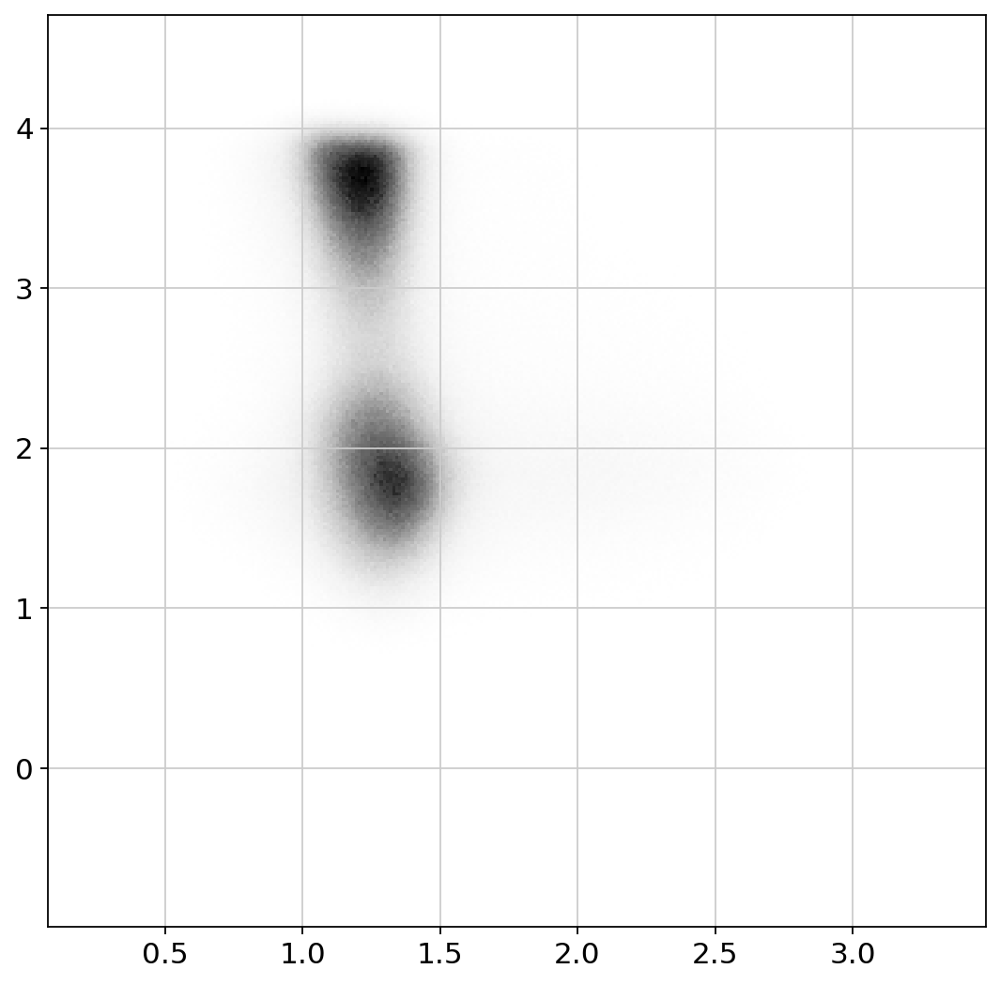

In [148]:
x1=adata_sub_subsampled[:,['CD185 (CXCR5)_logicle']].X
y1=adata_sub_subsampled[:,['CD45RA_logicle']].X
x1=np.array(x1).flatten()
y1=np.array(y1).flatten()
plt.hist2d( x1,y1, bins=(300, 300), cmap=plt.cm.Greys)
plt.show()

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:770: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(adata.obs[groupby]):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a 

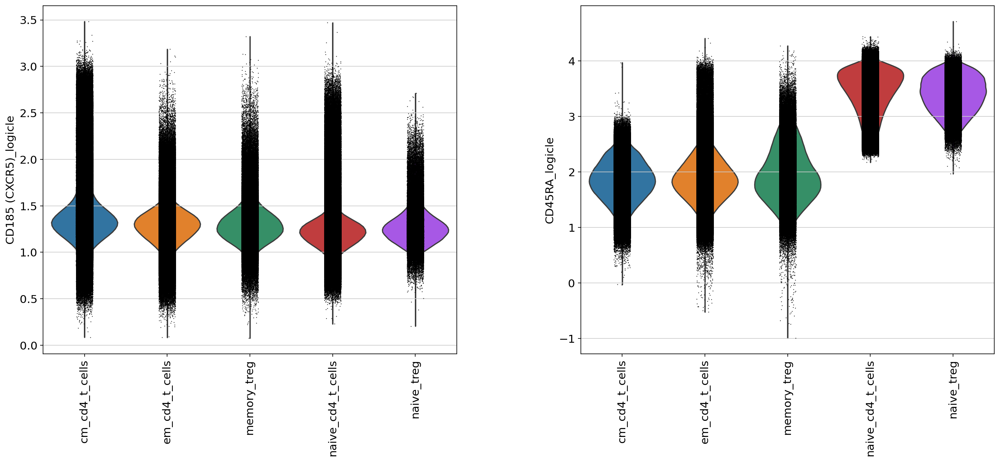

In [151]:
sc.pl.violin(adata_sub_subsampled, keys=['CD185 (CXCR5)_logicle','CD45RA_logicle'], groupby='labels', rotation=90)
